# Generate inteferograms without the need to download OPERA CSLC-S1 products locally
## This tutorial demonstrates how to query and work with the OPERA CSLC-S1 provisional data products from AWS S3 bucket.

---    

### Data Used in the Example:   

- **10 meter (Northing) x 5 meter (Easting) North America OPERA Coregistered Single Look Complex from Sentinel-1 provisional product**
    - This dataset contains Level-2 OPERA provisional coregistered single-look-complex (CSLC) data from Sentinel-1 (S1). <span style="color:red"> The data in this example are provisional, non-validated, geocoded CSLC-S1 data covering the 2019 Ridgecrest earthquake in California</span>. 
    
    - The OPERA project is generating geocoded burst-wise CSLC-S1 products over North America which includes USA and US Territories within 200 km from the US border, Canada, and all mainland countries from the southern US border down to and including Panama. Each pixel within a burst SLC is represented by a complex number and contains both the amplitude and phase information. The CSLC-S1 products are distributed over projected map coordinates using the Universal Transverse Mercator (UTM) projection with spacing in the X- and Y-directions of 5 m and 10 m, respectively. Each OPERA CSLC-S1 product is distributed as a HDF5 file following the CF-1.8 convention with separate groups containing the data raster layers, the low-resolution correction layers, and relevant product metadata.

    - For more information about the OPERA project and other products please visit our website at https://www.jpl.nasa.gov/go/opera .

- **Science Dataset (SDS) layer: Ridgecrest Earthquakes**
    - An earthquake sequence occurred near Ridgecrest, CA that consists of two mainshocks: Mw 6.4 on July 4, 2019, and 7.1 on July 5, 2019 (local time), with numerous aftershocks. This was the largest earthquake in Southern California since the 1999 Hetcor Mine earthquake [[USGS](https://earthquake.usgs.gov/storymap/index-ridgecrest.html)]. Here, we demonstrate how to create an interferogram and calculate for the interferometric coherence using pre-event (July 04, 2019) and after event (July 16, 2019) CSLC-S1 products. 

Please refer to the [OPERA Product Specification Document](https://d2pn8kiwq2w21t.cloudfront.net/documents/ProductSpec_CSLC_URS314199.pdf) for details about the CSLC-S1 product.

*Prepared by M. Grace Bato and K. Devlin*

---
## 1. Getting Started <a id="getstarted"></a>

### 1.1 Import Packages <a id="1.1"></a>

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import glob
import h5py
import fsspec
from pyproj import Proj, CRS
import matplotlib.pyplot as plt
import shapely.wkt as wkt
import rasterio
from rasterio.crs import CRS
from rasterio.transform import from_origin
from rasterio import merge
import folium
from folium import plugins
import rioxarray
import matplotlib as mpl
import sys
sys.path.append('../../')
from src.cslc_utils import get_s3path, read_cslc, cslc_info, rasterWrite, custom_merge, colorize, getbasemaps, moving_window_mean

import warnings
warnings.filterwarnings('ignore')

## 2. Stream products from the S3 bucket

### 2.1 Define the burst IDs and dates

OPERA CSLC-S1 products are provided on a burst-wise basis. Here, we stream the bursts covering the area of interest over the earthquake sequence rather than download them. The streaming saves the end-user storage space but this process requires higher memory (RAM) resource. Note that the `burst_id` is consistent with the ESA published burst ID maps. To view/download the ESA burst ID maps, click [here](https://sar-mpc.eu/files/S1_burstid_20220530.zip).
**This notebook allows the user to choose between CSLC-S1 GAMMA version or CalVal version. Please select the desired version in the cell below**

In [3]:
#version = 'calval' #uncomment to use CalVal version
version = 'gamma' #uncomment to use GAMMA version

if version == 'gamma':
    data_dir = 's3://opera-pst-rs-pop1/products/cslc_historical_20190701_to_20190718/'
    burst_id = ['T071-151217-IW3', 
                'T071-151217-IW2', 
                'T071-151218-IW3',
                'T071-151218-IW2', 
                'T071-151219-IW3',
                'T071-151219-IW2', 
                'T071-151220-IW2']
    # burst_id = ['T071-151217-IW2', 'T071-151218-IW2']  #Test for at least 2 burst_ids  
else:    
    data_dir = 's3://opera-provisional-products/CSLC/Ridgecrest/Descending'
    burst_id = ['t071_151217_iw3', 
                't071_151217_iw2', 
                't071_151218_iw3',
                't071_151218_iw2', 
                't071_151219_iw3',
                't071_151219_iw2', 
                't071_151220_iw2']
    #burst_id = ['t071_151217_iw2', 't071_151218_iw2']  #Test for at least 2 burst_ids
date = ['20190704', '20190716']
save_fn = f'Ridgecrest_{date[1]}-{date[0]}_{burst_id[0][:4]}.tif'

### 2.2 Get the full s3 path based on `burst_id` and `date` and stream the CSLC-S1 data

In [4]:
# Read before and after event dataset 
before = []; after = []  

for id in burst_id:
    if version == 'gamma':
        path_h5 = get_s3path(data_dir, id, date[0])
        dat = read_cslc(path_h5,'gamma')
    else:    
        path_h5 = f'{data_dir}/{id}/{date[0]}/{id}_{date[0]}.h5' 
        dat = read_cslc(path_h5)
    before.append(dat)

for id in burst_id:
    if version == 'gamma':
        path_h5 = get_s3path(data_dir, id, date[1])
        dat = read_cslc(path_h5,'gamma')
    else:    
        path_h5 = f'{data_dir}/{id}/{date[1]}/{id}_{date[1]}.h5' 
        dat = read_cslc(path_h5)
    after.append(dat)


Streaming: s3://opera-pst-rs-pop1/products/cslc_historical_20190701_to_20190718/OPERA_L2_CSLC-S1A_IW_T071-151217-IW3_VV_20190704T135204Z_v0.0_20230527T050025Z/OPERA_L2_CSLC-S1A_IW_T071-151217-IW3_VV_20190704T135204Z_v0.0_20230527T050025Z.h5
Streaming: s3://opera-pst-rs-pop1/products/cslc_historical_20190701_to_20190718/OPERA_L2_CSLC-S1A_IW_T071-151217-IW2_VV_20190704T135203Z_v0.0_20230527T050025Z/OPERA_L2_CSLC-S1A_IW_T071-151217-IW2_VV_20190704T135203Z_v0.0_20230527T050025Z.h5
Streaming: s3://opera-pst-rs-pop1/products/cslc_historical_20190701_to_20190718/OPERA_L2_CSLC-S1A_IW_T071-151218-IW3_VV_20190704T135207Z_v0.0_20230527T050025Z/OPERA_L2_CSLC-S1A_IW_T071-151218-IW3_VV_20190704T135207Z_v0.0_20230527T050025Z.h5
Streaming: s3://opera-pst-rs-pop1/products/cslc_historical_20190701_to_20190718/OPERA_L2_CSLC-S1A_IW_T071-151218-IW2_VV_20190704T135206Z_v0.0_20230527T050025Z/OPERA_L2_CSLC-S1A_IW_T071-151218-IW2_VV_20190704T135206Z_v0.0_20230527T050025Z.h5
Streaming: s3://opera-pst-rs-pop1/pr

## 3. Generate interferograms, save as GeoTiffs, and plot

An interferogram, $I$, given by the following equation:

$$
I_{1 2} = C_1 C_2 e^{j (\phi_1 - \phi_2)}
$$

can be formed by simply cross-multiplying the two geocoded OPERA CSLC-S1: `cslc1 *np.conj(cslc2)`.

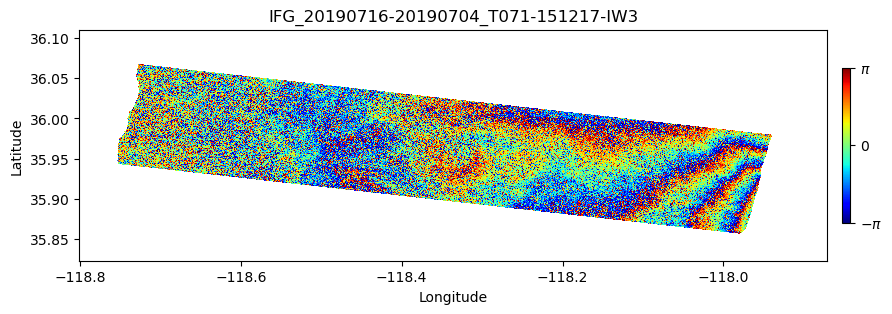

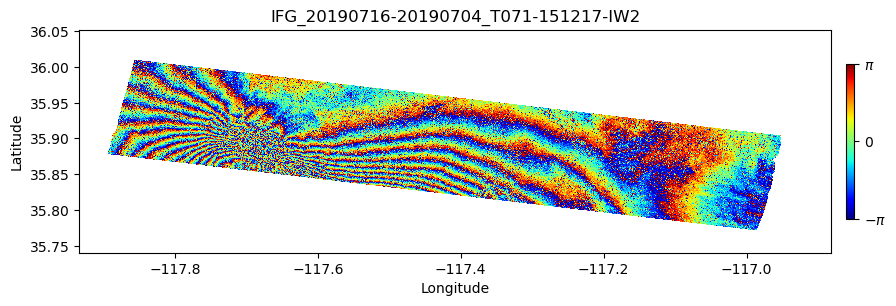

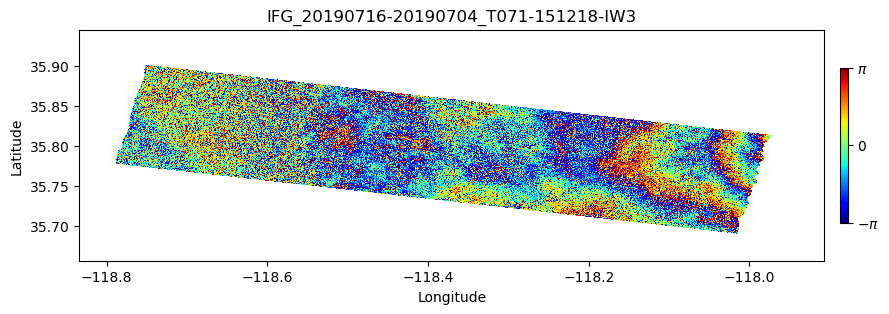

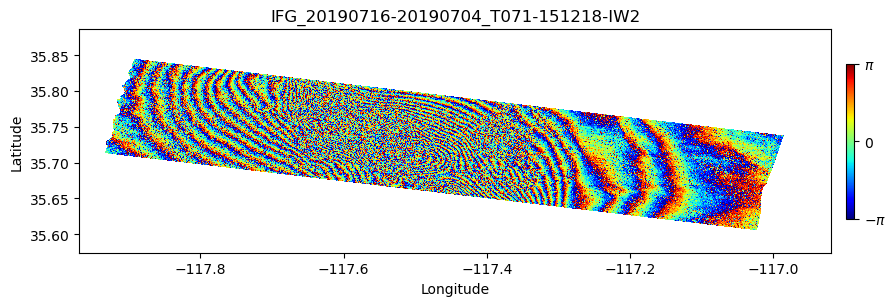

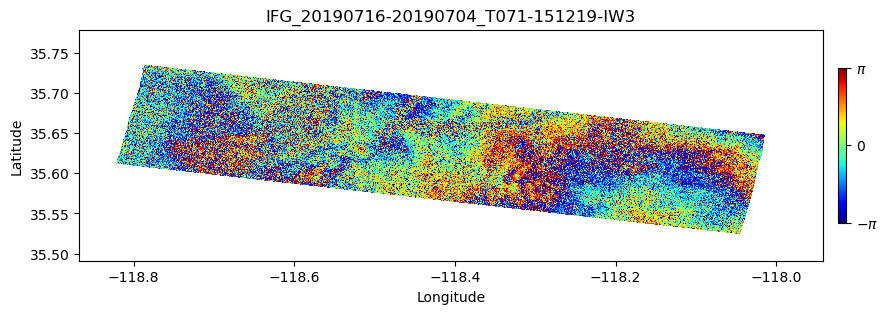

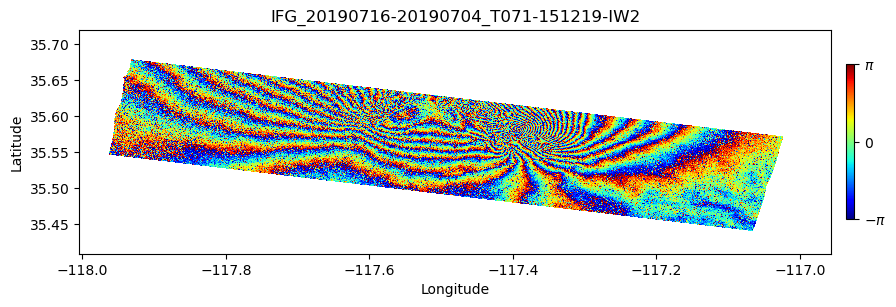

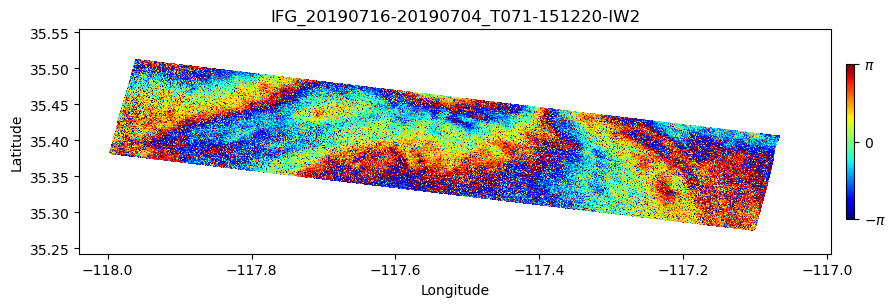

In [5]:
%matplotlib inline

for i, id in enumerate(burst_id):
    path_h5 = get_s3path(data_dir, id, date[0])
    xcoor, ycoor, dx, dy, epsg, bounding_polygon, orbit_direction = cslc_info(path_h5, version='gamma')
    cslc_poly = wkt.loads(bounding_polygon)
    bbox = [cslc_poly.bounds[0], cslc_poly.bounds[2], cslc_poly.bounds[1], cslc_poly.bounds[3]]

    # Calculate burst-wise interferogram
    ifg = after[i] * np.conj(before[i])
    
    # Plot each interferogram
    fig, ax = plt.subplots(figsize=(10,3))
    cax = ax.imshow(colorize(np.angle(ifg), 'jet', -np.pi, np.pi), cmap='jet',interpolation='nearest', origin='upper',extent=bbox, vmin=-np.pi, vmax=np.pi)
    cbar = fig.colorbar(cax,orientation='vertical',fraction=0.01,pad=0.02)
    cbar.set_ticks([-np.pi, 0., np.pi])
    cbar.set_ticklabels([r'$-\pi$', '$0$', r'$\pi$'])
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(f'IFG_{date[1]}-{date[0]}_{id}',fontsize=12)

    # Save each interferogram as GeoTiff
    transform = from_origin(xcoor[0],ycoor[0],dx,np.abs(dy))
    rasterWrite(f'ifg_{id}.tif',np.angle(ifg),transform,epsg,dtype=rasterio.float32)
    
# after = []; before=[]

## 4. Create merged interferogram

### 4.1 Merge bursts using `rasterio` and save the file as GeoTiff

In [6]:
# Merge GeoTiff files with rasterio
ifg_files = [(f'ifg_{id}.tif') for id in burst_id]
ifg_files_to_mosaic = []

for f in ifg_files:
    src = rasterio.open(f)
    ifg_files_to_mosaic.append(src)

# Write merged interferogram to GeoTiff
dest, output_transform=merge.merge(ifg_files_to_mosaic, method=custom_merge)
with rasterio.open(ifg_files[0]) as src:
        out_meta = src.meta.copy() 
out_meta.update({"driver": "GTiff",
                 "height": dest.shape[1],
                 "width": dest.shape[2],
                 "transform": output_transform})
with rasterio.open(save_fn, "w", **out_meta) as dest1:
        dest1.write(dest)
        dest1.close()

# print(dest.shape)

### 4.2 Read in merged interferogram

In [7]:
# Read the merged raster file
src = rioxarray.open_rasterio(save_fn)
merged_ifg = src.rio.reproject("EPSG:4326")[0]             # Folium maps are in EPSG:4326
minlon,minlat,maxlon,maxlat = merged_ifg.rio.bounds()

# Downsample for folium visualization and attach RGBA color to numpy array
colored_merged_ifg = colorize(merged_ifg[::6][::6], 'jet', -np.pi, np.pi)

### 4.3 Plot the merged interferogram uisng `matplotlib`

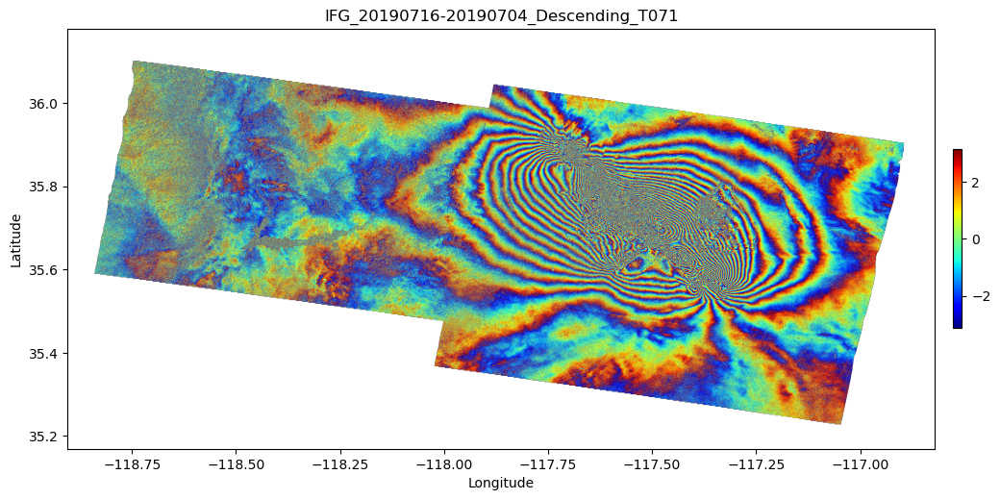

In [8]:
# Define new bounding box
new_bbox = [minlon,maxlon,minlat,maxlat]

# Plot using Matplotlib
fig, ax = plt.subplots(figsize=[12,9])
cax = ax.imshow(colored_merged_ifg, cmap='jet',interpolation=None, origin='upper',extent=new_bbox, vmin=-np.pi, vmax=np.pi)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title(f'IFG_{date[1]}-{date[0]}_{orbit_direction}_{burst_id[0][:4]}',fontsize=12)
fig.colorbar(cax,orientation='vertical',fraction=0.01,pad=0.02)
plt.show()

## 5. Calculate the coherence

Coherence ($\gamma$) is a qualitative marker for the interferogram, ranging between 0 and 1. Changes in the acquisition geometry and scattering (e.g. vegetation) and large amounts of surface deformation (> 2 \pi radians) lead to decorrelation. The higher the decorrelation, the lower the coherence, as can be observed closest to the surface rupture. Coherence is computed using a n x n window on full-resolution data. The equation for coherence is below, where *a* is the first CSLC, *b* is the the second CSLC, * denotes the complex conjugate, and ⟨⟩ denotes a spatial average.

$$
\gamma = \frac{\left | \left \langle ab^{*} \right \rangle \right |}{\sqrt{\left \langle aa^{*} \right \rangle\left \langle bb^{*} \right \rangle}}
$$

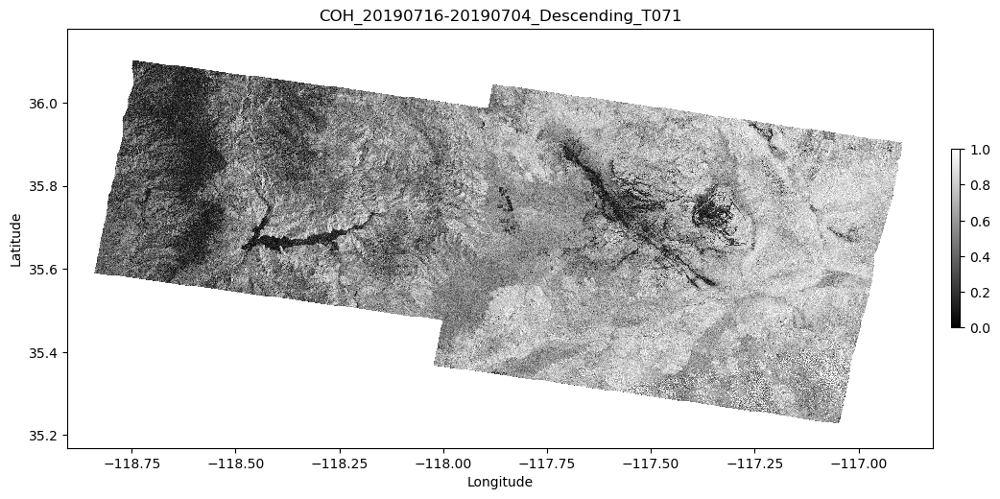

In [9]:
# Calculate the correlation/coherence
merged_ifg_cpx = np.exp(1j * np.nan_to_num(merged_ifg))
coh = np.clip(np.abs(moving_window_mean(merged_ifg_cpx, 10)), 0, 1)

# Mask nan values and zero values based on merged ifg file
nan_mask = np.isnan(merged_ifg)
zero_mask = merged_ifg == 0
coh[nan_mask] = np.nan
coh[zero_mask] = 0

# Downsample for folium visualization and attach RGBA color to numpy array
colored_coh = colorize(coh[::6][::6], 'gray', 0., 1)

# Plot
fig, ax = plt.subplots(figsize=(12,9))
cax = ax.imshow(colored_coh, cmap='gray',interpolation='nearest', origin='upper',extent=new_bbox, vmin=0., vmax=1.)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title(f'COH_{date[1]}-{date[0]}_{orbit_direction}_{burst_id[0][:4]}',fontsize=12)
fig.colorbar(cax,orientation='vertical',fraction=0.01,pad=0.02)
plt.show()

## 6. Visualize the merged interferogram and coherence with Folium


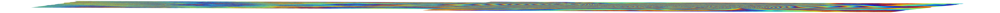
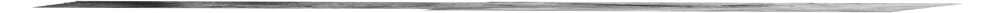

In [10]:
# Overlay merged bursts onto a basemap.
# Initialize Folium basemap and define center of mapview
xmid =(new_bbox[0]+new_bbox[1])/2 ; ymid = (new_bbox[2]+new_bbox[3])/2
m = folium.Map(location=[ymid, xmid], zoom_start=9, tiles='Stamen Terrain', show=True)

# Add custom basemaps
basemaps = getbasemaps()
for basemap in basemaps:
    basemaps[basemap].add_to(m)

# Overlay merged interferogram on a basemap
folium.raster_layers.ImageOverlay(colored_merged_ifg, 
                                        opacity=1.0, 
                                        bounds=[[new_bbox[2],new_bbox[0]],[new_bbox[3],new_bbox[1]]],
                                        interactive=False,
                                        name='Phase',
                                        show=True).add_to(m)

# Include coherence as a layer
folium.raster_layers.ImageOverlay(colored_coh, 
                                        opacity=0.6, 
                                        bounds=[[new_bbox[2],new_bbox[0]],[new_bbox[3],new_bbox[1]]],
                                        interactive=False,
                                        name='Coherence',
                                        show=True).add_to(m)


#layer Control
m.add_child(folium.LayerControl())

# Add fullscreen button
plugins.Fullscreen().add_to(m)

#Add inset minimap image
minimap = plugins.MiniMap(width=300, height=300)
m.add_child(minimap)

#Mouse Position
fmtr = "function(num) {return L.Util.formatNum(num, 3) + ' º ';};"
plugins.MousePosition(position='bottomright', separator=' | ', prefix="Lat/Lon:",
                     lat_formatter=fmtr, lng_formatter=fmtr).add_to(m)

#Display
m